# Visualization 🤝

**Title :** $\textit{Python | Plotly | express | graphic_objects}$\
**Author :** $\textit{Manideep Bangaru}$ 👨🏻‍💻

$\small \text{on 11/12/2020}$

In [117]:
# installing required libraries
# !pip install pandas
# !pip install plotly
# !pip install wheel

## imports

In [147]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import cufflinks as cf
import chart_studio.plotly as py


# if you want you plots to retain in Jupyter notebooks
from plotly.offline import download_plotlyjs,init_notebook_mode,plot,iplot
init_notebook_mode(connected=True)

# To make everything work locally
cf.go_offline()

## Basics

In [170]:
# Create a dataframe using a NumPy array that is 50 by 4
arr_1 = np.random.randn(50,4)
df_1 = pd.DataFrame(arr_1,columns=["A","B","C","D"])
df_1.head()

,A,B,C,D
0,-0.932939,1.366802,0.517900,0.436056
1,0.506337,0.149803,-0.274451,-1.037852
2,0.412198,0.848488,2.072128,0.531988
3,0.897326,0.908106,0.163875,-0.473728
4,-0.038507,0.878150,1.072183,-1.796727


<AxesSubplot:>

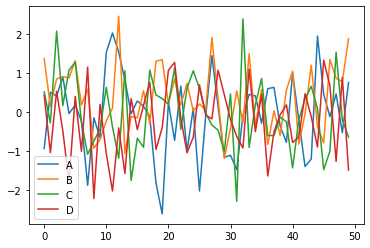

In [172]:
# old kind of plots
df_1.plot()

In [173]:
# Compare old plots to a Plotly interactive plot
# You can save as PNG, Zoom, Pan, Turn off & on Data and more
df_1.iplot()

## Line plots

In [174]:
# Allows us to create graph objects for making more customized plots
import plotly.graph_objects as go

df_stocks = px.data.stocks()
df_stocks.head()

,date,GOOG,AAPL,AMZN,FB,NFLX,MSFT
0,2018-01-01,1.000000,1.000000,1.000000,1.000000,1.000000,1.000000
1,2018-01-08,1.018172,1.011943,1.061881,0.959968,1.053526,1.015988
2,2018-01-15,1.032008,1.019771,1.053240,0.970243,1.049860,1.020524
3,2018-01-22,1.066783,0.980057,1.140676,1.016858,1.307681,1.066561
4,2018-01-29,1.008773,0.917143,1.163374,1.018357,1.273537,1.040708


In [175]:
# Use included Google price data to make one plot
px.line(df_stocks,x = "date", y = "GOOG", labels = {"date" : "Date", "GOOG" : "Price"})

In [176]:
# Make multiple line plots
px.line(df_stocks,x = "date", y = ["GOOG","AAPL"], labels = {"x" : "Date", "y" : "Price"},title="Apple vs Google")

In [178]:
# Complex type of plotting
# Create a figure to which I'll add plots 
fig = go.Figure()

# You can pull individual columns of data from the dataset and use markers or not
fig.add_trace(go.Scatter(x = df_stocks.date, y = df_stocks.AAPL, mode = "lines", name = "Apple"))
fig.add_trace(go.Scatter(x = df_stocks.date, y = df_stocks.AMZN, mode = "lines+markers", name = "Amazon"))

# You can create custom lines (Dashes : dash, dot, dashdot)
fig.add_trace(go.Scatter(x = df_stocks.date, y = df_stocks.GOOG, mode = "lines+markers", name = "Google",
                         line = dict(color="firebrick", width=2, dash = "dashdot")))

#fig.update_layout(title = "Stock Price data 2018 - 2020",
#                 xaxis_title = "Date",yaxis_title = "Price")

# we can go crazy styling the figure

fig.update_layout( # Shows gray line without grid, styling fonts, linewidths and more
                   xaxis = dict(showline = True, showgrid = False, showticklabels = True,
                               linecolor = "rgb(230,230,340)",linewidth = 2, ticks = "outside",
                               tickfont = dict(family = "Arial", size = 12, color = "rgb(70,54,67)")),
                  # Turn off everything on y axis
                  yaxis = dict(showgrid = False, zeroline = False, showline = False, showticklabels = False),
                  autosize = False,
                  margin = dict(autoexpand = False, l = 100, r = 20, t = 110),
                  showlegend = False, plot_bgcolor = "white")

## Bar charts

In [180]:
# # Get population change in US by querying for Canada data
df_us = px.data.gapminder().query("country == 'Canada'")
df_us.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
240,Canada,Americas,1952,68.75,14785584,11367.16112,CAN,124
241,Canada,Americas,1957,69.96,17010154,12489.95006,CAN,124
242,Canada,Americas,1962,71.30,18985849,13462.48555,CAN,124
243,Canada,Americas,1967,72.13,20819767,16076.58803,CAN,124
244,Canada,Americas,1972,72.88,22284500,18970.57086,CAN,124


In [126]:
# Simple bar plot
px.bar(df_us, x = 'year', y = 'pop')

In [127]:
# import another data
df_tips = px.data.tips()
df_tips.head()

,total_bill,tip,sex,smoker,day,time,size
0,16.99,1.01,Female,No,Sun,Dinner,2
1,10.34,1.66,Male,No,Sun,Dinner,3
2,21.01,3.50,Male,No,Sun,Dinner,3
3,23.68,3.31,Male,No,Sun,Dinner,2
4,24.59,3.61,Female,No,Sun,Dinner,4


In [181]:
# Create a stacked bar with more customization
px.bar(df_tips, x = "day", y = "tip", color = "sex",
       title = "Tips by sex on each day",
      labels = {'tip':'Tip amount','day':'Day of the week'})

In [182]:
# side by side bar plot
px.bar(df_tips, x = "sex", y = "total_bill", color = "smoker",
      barmode = 'group')

In [183]:
# Display pop data for countries in Europe in 2007 greater than 2000000
df_europe = px.data.gapminder().query("continent == 'Europe' and year==2007 and pop>2.e6")
df_europe.head()

,country,continent,year,lifeExp,pop,gdpPercap,iso_alpha,iso_num
23,Albania,Europe,2007,76.423,3600523,5937.029526,ALB,8
83,Austria,Europe,2007,79.829,8199783,36126.492700,AUT,40
119,Belgium,Europe,2007,79.441,10392226,33692.605080,BEL,56
155,Bosnia and Herzegovina,Europe,2007,74.852,4552198,7446.298803,BIH,70
191,Bulgaria,Europe,2007,73.005,7322858,10680.792820,BGR,100


In [185]:
fig = px.bar(df_europe, y = "pop", x = "country", text = "pop", color = "country")

# Put bar total value above bars with 2 values of precision
fig.update_traces(texttemplate = "%{text:.2s}",textposition = 'outside')

# Set fontsize and uniformtext_mode='hide' says to hide the text if it won't fit
fig.update_layout(uniformtext_minsize = 8)

# Rotate labels 45 degrees
fig.update_layout(xaxis_tickangle = -45)
fig

## Scatter plot

In [186]:
# Use included Iris data set
df_iris = px.data.iris()

# Create a scatter plot by defining x, y, different color for count of provided
# column, size based on supplied column and additional data to display on hover
px.scatter(df_iris, x="sepal_width", y="sepal_length", color="species",
                 size='petal_length', hover_data=['petal_width'])

In [133]:
# Create a customized scatter with black marker edges with line width 2, opaque
# and colored based on width. Also show a scale on the right
fig = go.Figure()
fig.add_trace(go.Scatter(
    x=df_iris.sepal_width, y=df_iris.sepal_length,
    mode='markers',
    marker_color=df_iris.sepal_width,
    text=df_iris.species,
    marker=dict(showscale=True)
))
fig.update_traces(marker_line_width=2, marker_size=10)

In [134]:
# Working with a lot of data use Scattergl
fig = go.Figure(data=go.Scattergl(
    x = np.random.randn(100000),
    y = np.random.randn(100000),
    mode='markers',
    marker=dict(
        color=np.random.randn(100000),
        colorscale='Viridis',
        line_width=1
    )
))
fig

## Pie charts

In [135]:
# Create Pie chart of the largest nations in Asia
# Color maps here plotly.com/python/builtin-colorscales/
df_samer = px.data.gapminder().query("year == 2007").query("continent == 'Asia'")
px.pie(df_samer, values='pop', names='country', 
       title='Population of Asian continent',
       color_discrete_sequence=px.colors.sequential.RdBu)

In [136]:
# Customize pie chart
colors = ['blue', 'green', 'black', 'purple', 'red', 'brown']
fig = go.Figure(data=[go.Pie(labels=['Water','Grass','Normal','Psychic', 'Fire', 'Ground'], 
                       values=[110,90,80,80,70,60])])
# Define hover info, text size, pull amount for each pie slice, and stroke
fig.update_traces(hoverinfo='label+percent', textfont_size=20,
                  textinfo='label+percent', pull=[0.1, 0, 0.2, 0, 0, 0],
                  marker=dict(colors=colors, line=dict(color='#FFFFFF', width=2)))

## Histograms

In [137]:
# Plot histogram based on rolling 2 dice
dice_1 = np.random.randint(1,7,5000)
dice_2 = np.random.randint(1,7,5000)
dice_sum = dice_1 + dice_2
# bins represent the number of bars to make
# Can define x label, color, title
# marginal creates another plot (violin, box, rug)
fig = px.histogram(dice_sum, nbins=11, labels={'value':'Dice Roll'},
             title='5000 Dice Roll Histogram', marginal='violin',
            color_discrete_sequence=['green'])

fig.update_layout(
    xaxis_title_text='Dice Roll',
    yaxis_title_text='Dice Sum',
    bargap=0.2, showlegend=False
)


In [138]:
# Stack histograms based on different column data
df_tips = px.data.tips()
px.histogram(df_tips, x="total_bill", color="sex")

## Box plots

In [139]:
# A box plot allows you to compare different variables
# The box shows the quartiles of the data. The bar in the middle is the median 
# The whiskers extend to all the other data aside from the points that are considered
# to be outliers
df_tips = px.data.tips()
# We can see which sex tips the most, points displays all the data points
px.box(df_tips, x='sex', y='tip', points='all')

In [140]:
# Display tip sex data by day
px.box(df_tips, x='day', y='tip', color='sex')

In [141]:
# Adding standard deviation and mean
fig = go.Figure()
fig.add_trace(go.Box(x=df_tips.sex, y=df_tips.tip, marker_color='blue',
                    boxmean='sd'))

In [142]:
# Complex Styling
df_stocks = px.data.stocks()
fig = go.Figure()
# Show all points, spread them so they don't overlap and change whisker width
fig.add_trace(go.Box(y=df_stocks.GOOG, boxpoints='all', name='Google',
                    fillcolor='blue', jitter=0.5, whiskerwidth=0.2))
fig.add_trace(go.Box(y=df_stocks.AAPL, boxpoints='all', name='Apple',
                    fillcolor='red', jitter=0.5, whiskerwidth=0.2))
# Change background / grid colors
fig.update_layout(title='Google vs. Apple', 
                  yaxis=dict(gridcolor='rgb(255, 255, 255)',
                 gridwidth=3),
                 paper_bgcolor='rgb(243, 243, 243)',
                 plot_bgcolor='rgb(243, 243, 243)')

## Violin plot

In [143]:
# Violin Plot is a combination of the boxplot and KDE
# While a box plot corresponds to data points, the violin plot uses the KDE estimation
# of the data points
df_tips = px.data.tips()
px.violin(df_tips, y="total_bill", box=True, points='all')

In [144]:
# Multiple plots
px.violin(df_tips, y="tip", x="smoker", color="sex", box=True, points="all",
          hover_data=df_tips.columns)

In [145]:
# Morph left and right sides based on if the customer smokes
fig = go.Figure()
fig.add_trace(go.Violin(x=df_tips['day'][ df_tips['smoker'] == 'Yes' ],
                        y=df_tips['total_bill'][ df_tips['smoker'] == 'Yes' ],
                        legendgroup='Yes', scalegroup='Yes', name='Yes',
                        side='negative',
                        line_color='blue'))
fig.add_trace(go.Violin(x=df_tips['day'][ df_tips['smoker'] == 'No' ],
                        y=df_tips['total_bill'][ df_tips['smoker'] == 'No' ],
                        legendgroup='Yes', scalegroup='Yes', name='No',
                        side='positive',
                        line_color='red'))

## Density Heatmap

In [152]:
import ssl
ssl._create_default_https_context = ssl._create_unverified_context

In [155]:
# Create a heatmap using Seaborn data
flights = sns.load_dataset("flights")
flights

,year,month,passengers
0,1949,Jan,112
1,1949,Feb,118
2,1949,Mar,132
3,1949,Apr,129
4,1949,May,121
...,...,...,...
139,1960,Aug,606
140,1960,Sep,508
141,1960,Oct,461
142,1960,Nov,390


In [156]:
# You can set bins with nbinsx and nbinsy
fig = px.density_heatmap(flights, x='year', y='month', z='passengers', 
                         color_continuous_scale="Viridis")
fig

In [157]:
# You can add histograms
fig = px.density_heatmap(flights, x='year', y='month', z='passengers', 
                         marginal_x="histogram", marginal_y="histogram")
fig

## 3D Scatter plots

In [158]:
# Create a 3D scatter plot using flight data
fig = px.scatter_3d(flights, x='year', y='month', z='passengers', color='year',
                   opacity=0.7, width=800, height=400)
fig

## 3D line plots

In [159]:
fig = px.line_3d(flights, x='year', y='month', z='passengers', color='year')
fig

## Scatter matrix

In [160]:
# With a scatter matrix we can compare changes when comparing column data
fig = px.scatter_matrix(flights, color='month')
fig

## Map Scatter plots

In [161]:
# There are many interesting ways of working with maps
# plotly.com/python-api-reference/generated/plotly.express.scatter_geo.html
df = px.data.gapminder().query("year == 2007")
fig = px.scatter_geo(df, locations="iso_alpha",
                     color="continent", # which column to use to set the color of markers
                     hover_name="country", # column added to hover information
                     size="pop", # size of markers
                     projection="orthographic")
fig


## Choropleth Maps

In [162]:
# You can color complex maps like we do here representing unemployment data

# Allows us to grab data from a supplied URL
from urllib.request import urlopen
# Used to decode JSON data
import json
# Grab US county geometry data
with urlopen('https://raw.githubusercontent.com/plotly/datasets/master/geojson-counties-fips.json') as response:
    counties = json.load(response)

# Grab unemployment data based on each counties Federal Information Processing number
df = pd.read_csv("https://raw.githubusercontent.com/plotly/datasets/master/fips-unemp-16.csv",
                   dtype={"fips": str})

# Draw map using the county JSON data, color using unemployment values on a range of 12
fig = px.choropleth(df, geojson=counties, locations='fips', color='unemp',
                           color_continuous_scale="Viridis",
                           range_color=(0, 12),
                           scope="usa",
                           labels={'unemp':'unemployment rate'}
                          )
fig

## Polar chart

In [163]:
# Polar charts display data radially 
# Let's plot wind data based on direction and frequency
# You can change size and auto-generate different symbols as well
df_wind = px.data.wind()
px.scatter_polar(df_wind, r="frequency", theta="direction", color="strength",
                size="frequency", symbol="strength")

In [164]:
# Data can also be plotted using lines radially
# A template makes the data easier to see
px.line_polar(df_wind, r="frequency", theta="direction", color="strength",
                line_close=True, template="plotly_dark", width=800, height=400)

## Ternary Plot

In [165]:
# Used to represent ratios of 3 variables
df_exp = px.data.experiment()
px.scatter_ternary(df_exp, a="experiment_1", b="experiment_2", 
                   c='experiment_3', hover_name="group", color="gender")

## Facets Plot

In [166]:
# You can create numerous subplots
df_tips = px.data.tips()
px.scatter(df_tips, x="total_bill", y="tip", color="smoker", facet_col="sex")

# We can line up data in rows and columns
px.histogram(df_tips, x="total_bill", y="tip", color="sex", facet_row="time", facet_col="day",
       category_orders={"day": ["Thur", "Fri", "Sat", "Sun"], "time": ["Lunch", "Dinner"]})

# This dataframe provides scores for different students based on the level
# of attention they could provide during testing
att_df = sns.load_dataset("attention")
fig = px.line(att_df, x='solutions', y='score', facet_col='subject',
             facet_col_wrap=5, title='Scores Based on Attention')
fig

## Animated Plots

In [168]:
# Create an animated plot that you can use to cycle through continent
# GDP & life expectancy changes
df_cnt = px.data.gapminder()
px.scatter(df_cnt, x="gdpPercap", y="lifeExp", animation_frame="year", 
           animation_group="country",
           size="pop", color="continent", hover_name="country",
           log_x=True, size_max=55, range_x=[100,100000], range_y=[25,90])

In [169]:
# Watch as bars chart population changes
px.bar(df_cnt, x="continent", y="pop", color="continent",
  animation_frame="year", animation_group="country", range_y=[0,4000000000])

<font color = "olive">$\Large \textbf{Thank you !!!}$</font>